# This notebook is used to answer Research Question 1: 

### How does the temporal lag between social media signals and Covid-19 cases and deaths data vary across time and space?

In [1]:
import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import argrelextrema
from datetime import timedelta  # Add this import for timedelta
import seaborn as sns
from datetime import datetime
from scipy.stats import pearsonr, spearmanr, kendalltau 
from matplotlib.lines import Line2D  
import geopandas as gpd

c:\Users\b1066706\Anaconda3\envs\geo_env\lib\site-packages\geopandas\_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(


# Functions

In [2]:
def plot_crosscorrelation_only_positive_custom_local_minima(df_aggr, covid_id, kw, cluster, lag_max=50, custom_timeframes=['2020-05-25', '2020-08-28', '2021-01-03', '2021-03-23',
                                                                                                                                                       '2021-06-27', '2021-11-07', '2022-04-19', '2022-08-24',
                                                                                                                                                       '2022-10-28', '2022-12-03'], plotting=True,start_lag = 7, figureid='noid'):
    covid_id_col = covid_id + '_' + str(cluster)
    kw_col = kw + '_' + str(cluster)

    local_minima = [datetime.strptime(date_str, "%Y-%m-%d") for date_str in custom_timeframes]

    rss = []  # List to store cross-correlation values for each timeframe
    start_date = df_aggr.index[0]
    max_tweets_ratio = []

    for minima_date in local_minima:
        end_date = minima_date

        # Extract data for the specific time frame
        df_subset_covid = df_aggr[covid_id_col].loc[(df_aggr.index >= start_date) & (df_aggr.index <= end_date)]
        df_subset_kw = df_aggr[kw_col].loc[(df_aggr.index >= start_date) & (df_aggr.index <= end_date)]

        # Calculate and store cross-correlation values for each lag
        rs = []
        for lag in range(0, lag_max + 1):
            rs.append(df_subset_covid.corr(df_subset_kw.shift(lag)))
        max_tweets_ratio.append(np.max(df_subset_kw))
        rss.append(rs)
        start_date = minima_date
    rss = pd.DataFrame(rss)
    # Plot the cross-correlation heatmap with 'RdBu_r' colormap (reversed)
    if plotting:
        fig, ax = plt.subplots(figsize=(16, 10), dpi=900)
        
        
        sns.heatmap(rss, cmap='RdBu_r', ax=ax, center=0)  # Set center to 0 for white to be at zero
        rss = rss.iloc[:,start_lag:43]
        # Set y-axis ticks and labels starting from 1
        ax.set_yticks(np.arange(0.5, len(local_minima), 1))
        ax.set_yticklabels(range(1, len(local_minima) + 1), fontsize=14)  # Increase font size for y-axis tick labels

        ax.set(
               xlim=[start_lag, (rss.shape[1])+start_lag], xlabel='Number of days the Tweets time series were shifted into the future',
               ylabel='Time frames defined by local minima in COVID-19 cases')

        # Increase font size for headline, x-axis label, and y-axis label
        ax.title.set_fontsize(20)
        ax.xaxis.label.set_fontsize(16)
        ax.yaxis.label.set_fontsize(16)

        ax.tick_params(axis='x', labelsize=12)  # Increase font size for x-axis tick labels

        ax.set_xticklabels([int(int(item)) for item in ax.get_xticks()])

        # Add zero offset markers
        for i in range(len(local_minima)):
            ax.add_patch(plt.Rectangle((0 + start_lag, i), 1, 1, fill=False, edgecolor='black', lw=2))
            max_value = rss.loc[i, 0 + start_lag]
            ax.text(0 + start_lag + 0.5, i + 0.5, f"{max_value:.2f}", ha='center', va='center', color='black', fontsize=15,
                    rotation=90, weight='bold')
        
        # Add max offset markers
        for i in range(len(local_minima)):
            ax.add_patch(plt.Rectangle((lag_max, i), 1, 1, fill=False, edgecolor='black', lw=2))
            max_value = rss.loc[i, lag_max]
            ax.text(lag_max + 0.5, i + 0.5, f"{max_value:.2f}", ha='center', va='center', color='black', fontsize=15,
                    rotation=90, weight='bold')



        # Add best correlation markers
        best_lags = []
        best_lags_corr = []
        zero_lags_corr = []
        
        for i in range(len(local_minima)):
            max_pos = rss.loc[i].idxmax()
            max_value = rss.loc[i, max_pos]
            zero_lag_value = rss.loc[i, 0 + start_lag]
            zero_lags_corr.append(zero_lag_value)
            best_lags.append(max_pos)
            best_lags_corr.append(max_value)
            ax.add_patch(plt.Rectangle((max_pos, i), 1, 1, fill=False, edgecolor='white', lw=2))
            ax.text(max_pos + 0.5, i + 0.5, f"{max_value:.2f}", ha='center', va='center', color='white', fontsize=15,
                    rotation=90, weight='bold')
            if max_value < 0.20:
                ax.add_patch(plt.Rectangle((max_pos, i), 1, 1, fill=False, edgecolor='grey', lw=2))
                ax.text(max_pos + 0.5, i + 0.5, f"{max_value:.2f}", ha='center', va='center', color='grey', fontsize=15,
                    rotation=90, weight='bold')

        # Increase font size for x-axis and y-axis labels
        ax.set_xlabel(ax.get_xlabel(), fontsize=20, labelpad=22)
        ax.set_ylabel(ax.get_ylabel(), fontsize=20)

        # Show the plot
        #print(best_lags)
        filepath = r"Figure"+figureid+".png"
        plt.tight_layout()
        plt.savefig(filepath, dpi=1200)
        plt.show()

        
    return best_lags, zero_lags_corr, best_lags_corr, max_tweets_ratio


In [3]:
def plot_time_frames_for_given_minimas_with_shift(df, covid_id, kw, cluster, custom_timeframes=None, shifts=None, num_dates=5, title_fontsize=20, individual_title_fontsize=18, legend_fontsize=14, figureid='noid'):
    covid_id_col = covid_id + '_' + str(cluster)
    kw_col = kw + '_' + str(cluster)

    local_minima = [datetime.strptime(date_str, "%Y-%m-%d") for date_str in custom_timeframes]

    # Create a grid of subplots
    num_plots = len(local_minima)
    cols = 2
    rows = (num_plots + 1) // 2  # Add 1 to round up if needed
    fig, axes = plt.subplots(rows, cols, figsize=(18, 12), dpi=900)

    # Flatten the axes array to handle different cases for odd and even numbers of plots
    axes = axes.flatten()
    start_date = df.index[0]

    # Construct the title with cluster information
    cluster_title = f"Cluster {cluster}"

    for i, minima_date in enumerate(local_minima):
        ax = axes[i]

        end_date = minima_date

        # Plot the time series for the specific time frame
        df_subset = df[(df.index >= start_date) & (df.index <= end_date)]

        # Plot the original tweet time series
        ax.plot(df_subset.index, df_subset[covid_id_col], label='COVID-19 cases', color='#840924')  # Changed y-axis label
        ax.set_ylabel('COVID-19 cases', color='#840924', fontsize=legend_fontsize)  # Changed y-axis label and increased font size
        ax.tick_params(axis='y', labelcolor='#840924', labelsize=legend_fontsize)  # Increased font size

        # Create a secondary y-axis on the right for the second time series
        ax2 = ax.twinx()

        # Plot the original tweet time series with label "Virus Topic"
        ax2.plot(df_subset.index, df_subset[kw_col], label='Tweets', color='#1d5fa2')

        # Shift the tweet time series into the future by the specified amount
        if shifts and shifts[i] > 0:
            # Plot the shifted tweet time series with 80% alpha
            ax2.plot(df_subset.index + pd.DateOffset(days=min(shifts[i], 31)), df_subset[kw_col],  # Limit shift to 10 days
                     label=f'Tweets (Shifted by {shifts[i]} days)', color='darkorange', alpha=0.8)
        ax2.set_ylabel('Tweets', color='#1d5fa2', fontsize=legend_fontsize)
        ax2.tick_params(axis='y', labelcolor='#1d5fa2', labelsize=legend_fontsize)  # Increased font size

        # Set x-axis ticks to show a limited number of dates
        date_ticks = df_subset.index[::max(len(df_subset.index)//num_dates, 1)]
        ax.set_xticks(date_ticks)
        ax.set_xticklabels([date.strftime("%Y-%m-%d") for date in date_ticks], fontsize=12)  # Increased font size

        # Add titles and legend in the middle upper position with increased font size
        title = f'Time frame {i + 1}: {start_date.strftime("%Y-%m-%d")} to {end_date.strftime("%Y-%m-%d")}'
        ax.set_title(title, fontsize=title_fontsize)

        # Increase the font size of individual subplot titles
        ax.title.set_fontsize(individual_title_fontsize)

        lines1, labels1 = ax.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax2.legend(lines1 + lines2, labels1 + labels2, loc='upper right', fontsize=legend_fontsize)  # Increase legend font size ;loc='upper right',

        # Adjust x-axis limits to prevent overlap
        ax.set_xlim(start_date, end_date)

        start_date = minima_date

    # Add a main title with cluster information
    #fig.suptitle('Tweets and COVID-19 Cases Time Series for '+str(cluster_title).replace('_',' '), fontsize=title_fontsize + 4, y=1.02)

    # Adjust layout and show the plot
    filepath = r"Figure"+figureid+".png"
    plt.tight_layout()
    plt.savefig(filepath, dpi=1200)
    plt.show()

# Example usage
# shifts = [0, 3, 2]  # Example shifts for each timeframe
# plot_time_frames_for_given_minimas_with_shift(df, 'cases', 'tweets', cluster=1, custom_timeframes=custom_timeframes, shifts=shifts, num_dates=5, title_fontsize=16, individual_title_fontsize=14, legend_fontsize=12)


In [4]:
def find_local_extrema(data):
    # Using scipy's argrelextrema to find local minima
    local_minima_idx = argrelextrema(data.values, comparator=lambda x, y: x < y, order=5)[0]
    local_minima = data.iloc[local_minima_idx]
    return local_minima

In [6]:
def load_features_data(start_date, end_date, mva=28):

    # collect all input features in a df list
    dfs = []

    # load the features which you want to predict, could be cases or deaths
    df_predict = pd.read_csv("../../data/covid19_cases/daily_new_cases.csv", index_col = 0)
    df_predict = df_predict[df_predict.index >= str(start_date)[:10]]
    df_predict = df_predict[df_predict.index < str(end_date)[:10]]
    dfs.append(df_predict.rolling(window=mva).mean().dropna())
    
    df_all_tweets = pd.read_csv("../../data/tweet_mats/tweets_all_tweets.csv", index_col = 0)
    df_all_tweets = df_all_tweets[df_all_tweets.index >= str(start_date)[:10]]
    df_all_tweets = df_all_tweets[df_all_tweets.index < str(end_date)[:10]]

    columns = [
    'keywords_covid_baseline_topic'
]

    for col in columns:
        df_tweets = pd.read_csv("../../data/tweet_mats/tweets_"+col+".csv", index_col = 0)
        df_tweets = df_tweets[df_tweets.index >= str(start_date)[:10]]
        df_tweets = df_tweets[df_tweets.index < str(end_date)[:10]]
        dfs.append((df_tweets.fillna(0).rolling(window=mva).mean().dropna()/df_all_tweets.fillna(0).rolling(window=mva).mean().dropna()).fillna(0))
    return dfs


In [7]:
def pop_normalize(data_df, county_data ):
    df = data_df.T#dfs[0].copy().T
    df['countyfips'] = df.index.astype('float').astype('int64')
    df_merged = pd.merge( df, county_data, on ='countyfips', how='left')
    df_pop_norm = df_merged.iloc[:,:-3].T/df_merged['population'].astype('float')
    df_result = df_pop_norm.T
    df_result['Clusters'] = df_merged['Clusters'].astype('str')
    df_result.index = df_merged['countyfips']
    return df_result

In [8]:
def aggregate_cases_tweets_per_cluster(dfs, corrwindow=84, mva =14):

    df_id = 'cases'
    df_cases = dfs[0]
    dfs_tweets = dfs[1:]
    
    # calcualte the rolling corr for each keyword and each cluster
    df_aggr = pd.DataFrame()
    keywords = [
    'Covid_Baseline_Topic'] #'all_keywords' still to add

    for cluster in set(df_cases.Clusters):

            # get all counties in one cluster
            df_cases_cluster = df_cases[df_cases['Clusters']==cluster].drop(['Clusters'], axis=1)

            # sum over all counties in one clusters, potenially apply another moving average
            cases_time_series = pd.DataFrame(np.mean(df_cases_cluster.T, axis=1)).rolling(window=mva).mean().fillna(0)

            # add to final correlation dataframe
            df_aggr[df_id+'_' +str(cluster)] = cases_time_series

            # now add tweets time series and calculate the correlations for each keyword time series
            for kw in range(0,len(keywords)):

                # add political cluster info to tweets data
                df_tweets = dfs_tweets[kw]
                df_tweets_T = df_tweets.T
                df_tweets_T['countyfips'] = df_tweets_T.index.astype('int64')
                df_tweets_clusters = pd.merge(df_tweets_T, df_cases['Clusters'].reset_index(), on='countyfips', how='left')

                # filter for all counties of a specific cluster
                df_tweets_cluster = df_tweets_clusters[df_tweets_clusters['Clusters']==cluster].drop(['Clusters','countyfips'], axis=1)
                tweets_time_series = pd.DataFrame(np.mean(df_tweets_cluster.T, axis=1)).rolling(window=mva).mean().fillna(0)
                df_aggr[keywords[kw]+'_' +cluster] = tweets_time_series
            
    return df_aggr


In [9]:
def plot_covid_cases_with_local_minima(
    df_cases, 
    days_to_shift=21, 
    exclude_dates=None, 
    cases_color='#840924', 
    color_tf='black', 
    color_leftout='grey', 
    save_path=None
):
    """
    Function to plot COVID-19 cases over time, highlight local minima, 
    and show time frames between local minima with optional exclusion of dates.

    Parameters:
    - df_cases: DataFrame with a 'cases' column and datetime index.
    - days_to_shift: Window size for rolling mean of cases.
    - exclude_dates: List of dates to exclude from local minima highlights.
    - cases_color: Color for the COVID-19 cases line plot.
    - color_tf: Color for the local minima markers.
    - color_leftout: Color for the excluded local minima markers.
    - save_path: If specified, saves the plot to the given path.

    Returns:
    - custom_timeframes: List of custom time frames between local minima.
    """

    if exclude_dates is None:
        exclude_dates = ['2021-01-16']

    df_cases = df_cases.copy()
    df_cases.index = pd.to_datetime(df_cases.index)
    df_cases['cases'] = df_cases['cases'].rolling(window=days_to_shift).mean()

    # Create figure and plot
    fig, ax1 = plt.subplots(figsize=(14, 6))
    cases_line, = ax1.plot(df_cases.index, df_cases['cases'], label='COVID-19 Cases', color=cases_color)

    # Finding local minima (replace with actual function)
    local_minima = find_local_extrema(df_cases['cases'])

    # Include the last date of the time series into local minima
    last_date = df_cases.index[-1]
    last_value = df_cases['cases'].iloc[-1]
    #local_minima = pd.concat([local_minima, pd.Series([last_value], index=[last_date])]) 
    # => this was used to add the the ending of the time series as a possible local minima if it was not found by the find_extrema function!

    # Highlight specific dates to be excluded
    highlight_dates = {pd.to_datetime(date): color_leftout for date in exclude_dates}
    for date, color in highlight_dates.items():
        if date in df_cases.index:
            ax1.scatter(date, df_cases.loc[date, 'cases'], color=color, marker='o', edgecolors=color_leftout, alpha=0.7, s=100, label='Left out Local Minima')
        if date in df_cases.index:
            scatter_highlight = ax1.scatter(date, df_cases.loc[date, 'cases'], color=color, marker='o', edgecolors=color_leftout, alpha=0.7, s=100, label='Left out Local Minima')

    # Handle custom timeframes and vertical lines
    custom_timeframes = []
    vertical_lines = []
    start_element = pd.Series([0], index=[pd.to_datetime('2020-03-09')])
    local_minima = pd.concat([start_element, local_minima])

    for idx in range(len(local_minima)):
        if local_minima.index[idx] in pd.to_datetime(exclude_dates):
            continue
        x_value = local_minima.index[idx]
        ax1.axvline(x=x_value, color='black', linestyle='-', alpha=1, linewidth=2)
        ax1.scatter(x_value, local_minima.values[idx], color=color_tf, label='Local Minima', s=100)
        scatter_minima = ax1.scatter(local_minima.index[idx], local_minima.values[idx], color=color_tf, label='Local Minima', s=100)

        custom_timeframes.append(str(x_value)[:10])
        vertical_lines.append(x_value)

    # Calculate midpoints between vertical lines
    midpoints = []
    for i in range(len(vertical_lines) - 1):
        midpoint = vertical_lines[i] + (vertical_lines[i + 1] - vertical_lines[i]) / 2
        midpoints.append(midpoint)
        ax1.text(midpoint, ax1.get_ylim()[1], f'Time frame {i + 1}', color='black', 
                 bbox=dict(facecolor='white', edgecolor='black', boxstyle='square,pad=0.45'),
                 fontsize=12, horizontalalignment='center', verticalalignment='center')

    # Add grid and formatting
    ax1.grid(True, linestyle='--', alpha=0.7)
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), handles=[cases_line, scatter_minima, scatter_highlight], labels=['Covid-19 Cases', 'Local Minima', 'Left out Local Minima'], markerfirst=False, markerscale=0.5, ncol=3,fontsize=15)  # Increased font size

    ax1.tick_params(axis='y', labelcolor=cases_color, labelsize=15)
    ax1.tick_params(axis='x', labelsize=15)
    ax1.set_xlabel('Date', fontsize=15)
    ax1.set_ylabel('COVID-19 cases normalized over country population', fontsize=15, color=cases_color)
    ax1.tick_params(axis='y', labelcolor=cases_color)

    # Save plot if save_path is provided
    if save_path:
        plt.savefig(save_path, dpi=500, bbox_inches='tight')
    
    plt.tight_layout()
    plt.show()

    custom_timeframes = custom_timeframes[1:]
    return custom_timeframes


# Load the data

In [10]:
mva = 14
pop_normalization = True

In [11]:
# training and testing timeframe
start_date = datetime(2020, 1, 29) #Fix! Do not change this is the beginning of the COVID-19 data
end_date = datetime(2022,5,1)

# load dataframe feature list
dfs = load_features_data(start_date, end_date, mva = mva)
# Position 0: cases
# Position 1-end: tweets 

county_data = gpd.read_file("../../data/utils/county_data.shp", index_col = 0)
voting_data = pd.read_csv('../../data/voting_data/votes_per_county_6elections.csv', index_col = 0)
# pop norm cases and add voting clusters
if pop_normalization:
    dfs[0] = pop_normalize(dfs[0].copy(), voting_data[['Clusters','countyfips','population']])

In [12]:
df_aggr= aggregate_cases_tweets_per_cluster(dfs.copy(), corrwindow=84, mva = 14) # This is a more eleborate funciton which is not necessray for this impler analysis.

In [13]:
df_aggr.columns

Index(['cases_Swing_County', 'Covid_Baseline_Topic_Swing_County',
       'cases_Republicans', 'Covid_Baseline_Topic_Republicans',
       'cases_No_Data', 'Covid_Baseline_Topic_No_Data', 'cases_Democrats',
       'Covid_Baseline_Topic_Democrats'],
      dtype='object')

In [14]:
df_aggr.index = pd.to_datetime(df_aggr.index)
 

In [15]:
df_cases_whole_us = pd.DataFrame(df_aggr.cases_Republicans+df_aggr.cases_Democrats+df_aggr.cases_Swing_County, columns = ['cases'])

# Create timeframes


## Plot single timeframes with both time series
### Costume local Minimas for the entire US

In [17]:
mva2 = 21
custom_timeframes = ['2020-06-08', '2020-09-29', '2021-04-07', '2021-07-13', '2021-11-22', '2022-04-25']

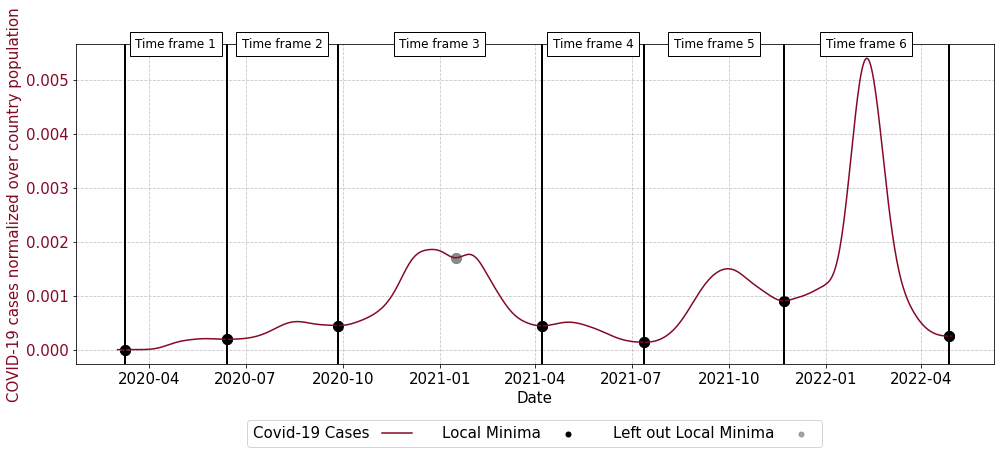

Custom timeframes: ['2020-06-13', '2020-09-26', '2021-04-07', '2021-07-13', '2021-11-22', '2022-04-27']


In [18]:
save_path = r"Figure2.png"  # Optional path to save the plot
exclude_dates = ['2021-01-16']

custom_timeframes = plot_covid_cases_with_local_minima(
    df_cases_whole_us.copy(), 
    days_to_shift=mva2, 
    exclude_dates=exclude_dates, 
    cases_color='#840924', 
    save_path=save_path
)

print("Custom timeframes:", custom_timeframes)

# Plot temporal lag per timefame: Individual Heatmap Plots for Custom local Minima

## Baseline Topic

In [19]:
topic = 'Covid_Baseline_Topic'

### Cluster Democratic

In [20]:
shifts_dem,_,_,max_tweets_ratio = plot_crosscorrelation_only_positive_custom_local_minima(df_aggr, 'cases', topic, 'Democrats', lag_max=42, custom_timeframes = custom_timeframes, start_lag=7, figureid='3' )
plot_time_frames_for_given_minimas_with_shift(df_aggr, 'cases', topic, 'Democrats', custom_timeframes,  shifts = shifts_dem, num_dates=6, figureid='4')# shifts need to be adjusted manually from the cell output from the cell before!

### Cluster Republican

In [21]:
shifts_rep,_,_,max_tweets_ratio = plot_crosscorrelation_only_positive_custom_local_minima(df_aggr, 'cases', topic, 'Republicans', lag_max=42, custom_timeframes = custom_timeframes, start_lag=7, figureid='5')
plot_time_frames_for_given_minimas_with_shift(df_aggr, 'cases', topic, 'Republicans', custom_timeframes,  shifts = shifts_rep, num_dates=6, figureid='6')


### Cluster Swing County

In [22]:
shifts_swing,_,_, max_tweets_ratio = plot_crosscorrelation_only_positive_custom_local_minima(df_aggr, 'cases', topic, 'Swing_County', lag_max=42, custom_timeframes = custom_timeframes, start_lag=7, figureid='7' )
plot_time_frames_for_given_minimas_with_shift(df_aggr, 'cases', topic, 'Swing_County', custom_timeframes,  shifts = shifts_swing, num_dates=6, figureid='8')# shifts need to be adjusted manually from the cell output from the cell before!